In [1]:
import time
import selfies as sf
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
from scipy.stats import uniform, randint

from sklearn.preprocessing import OneHotEncoder,StandardScaler, MinMaxScaler
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.linear_model import LogisticRegression
from sklearn.neural_network import MLPRegressor
from sklearn.metrics import PredictionErrorDisplay as PED
from sklearn.metrics import r2_score,mean_absolute_error, mean_squared_error
from sklearn.model_selection import cross_val_score,train_test_split, KFold,RandomizedSearchCV,GridSearchCV
import pickle
from joblib import dump, load

import datetime
import re

In [2]:
X=pd.read_pickle("/home/sat/ML_GAP/calc_descriptors_final.pkl")
X

,MaxAbsEStateIndex,MinAbsEStateIndex,MinEStateIndex,SPS,MolWt,NumRadicalElectrons,AvgIpc,BalabanJ,HallKierAlpha,Ipc,...,fr_NH0,fr_NH2,fr_allylic_oxid,fr_aniline,fr_aryl_methyl,fr_bicyclic,fr_ester,fr_ketone,fr_para_hydroxylation,fr_piperdine
0,13.421670,1.813652,-4.213449,93.904762,292.287,0,3.203010,2.128362,-1.40,7.621569,...,0,0,0,0,0,4,2,0,0,0
1,14.938999,0.626931,-6.373747,66.444444,660.651,0,3.295038,3.117964,-3.23,15.455677,...,1,1,2,0,0,0,2,2,0,0
2,15.674552,1.517576,-4.913705,45.409091,598.604,0,3.352137,1.857894,-4.67,14.762903,...,0,0,1,0,0,6,1,2,0,0
3,15.162100,1.184590,-4.773941,45.804878,554.551,0,3.323824,1.856690,-4.47,13.642638,...,0,0,1,0,0,6,1,2,0,0
4,14.690159,1.393863,-6.473465,57.538462,534.693,0,3.304427,2.630768,-3.15,15.271236,...,0,0,0,0,0,1,3,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
406198,13.510691,1.513305,-7.333639,19.571429,452.142,0,2.615850,6.583700,-2.04,6.309594,...,1,0,0,0,0,0,0,0,0,0
406199,15.059651,0.354457,-4.267296,30.500000,588.664,0,4.039629,2.336180,-5.31,15.206860,...,2,0,5,0,3,8,1,1,0,0
406200,9.735870,0.859880,-5.445191,72.090909,626.564,15,3.337697,1.973088,-0.64,15.536231,...,0,0,0,0,0,1,0,0,0,0
406201,15.164901,0.812307,-5.526028,60.818182,457.483,0,3.064037,2.520709,-3.11,11.652133,...,2,1,0,1,0,3,0,4,0,0


In [3]:
#log10 scaling in descriptors.ipynb
#print(X['Ipc'].max(),X['Ipc'].min())
#scaler = MinMaxScaler()
#X['Ipc'] = scaler.fit_transform(X['Ipc'].values.reshape(-1,1))
#print(X['Ipc'].max(),X['Ipc'].min())

In [4]:
scaler=StandardScaler().fit(X)
scaled=scaler.transform(X)
scaled

array([[ 0.02159097,  0.58775404,  0.62281861, ..., -0.49149382,
        -0.3225622 , -0.26182584],
       [ 0.68440624, -0.68406985, -0.89998339, ...,  2.57854662,
        -0.3225622 , -0.26182584],
       [ 1.00571817,  0.27044515,  0.12920525, ...,  2.57854662,
        -0.3225622 , -0.26182584],
       ...,
       [-1.58847822, -0.434415  , -0.24544081, ..., -0.49149382,
        -0.3225622 , -0.26182584],
       [ 0.78308735, -0.48539938, -0.30242338, ...,  5.64858707,
        -0.3225622 , -0.26182584],
       [-0.93406733,  0.24826159, -1.64346614, ..., -0.49149382,
        -0.3225622 ,  4.35244987]])

In [5]:
import missingno as msno

<Axes: >

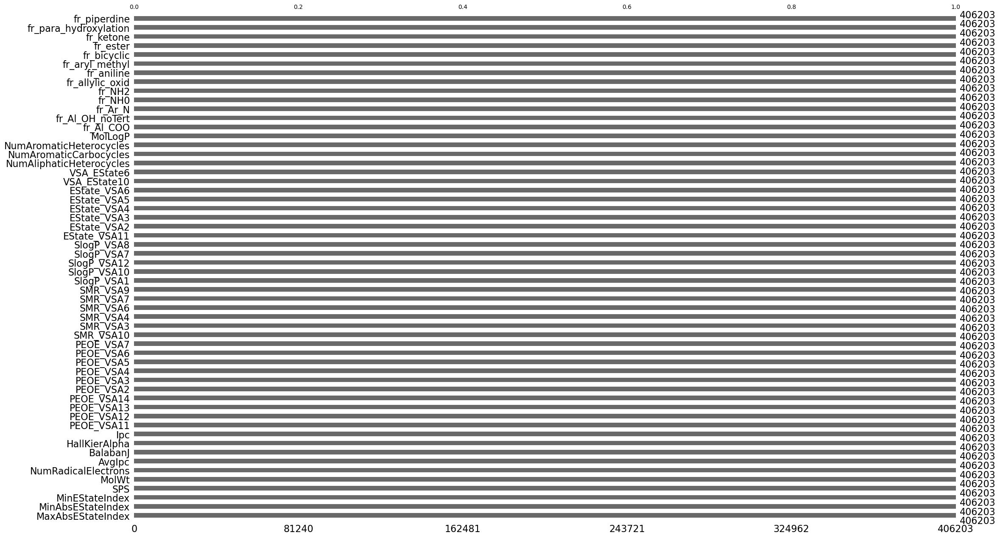

In [6]:
msno.bar(X)

In [7]:
scaled[np.isfinite(scaled).any(axis=1)]

array([[ 0.02159097,  0.58775404,  0.62281861, ..., -0.49149382,
        -0.3225622 , -0.26182584],
       [ 0.68440624, -0.68406985, -0.89998339, ...,  2.57854662,
        -0.3225622 , -0.26182584],
       [ 1.00571817,  0.27044515,  0.12920525, ...,  2.57854662,
        -0.3225622 , -0.26182584],
       ...,
       [-1.58847822, -0.434415  , -0.24544081, ..., -0.49149382,
        -0.3225622 , -0.26182584],
       [ 0.78308735, -0.48539938, -0.30242338, ...,  5.64858707,
        -0.3225622 , -0.26182584],
       [-0.93406733,  0.24826159, -1.64346614, ..., -0.49149382,
        -0.3225622 ,  4.35244987]])

In [8]:
df=pd.read_pickle("/home/sat/ML_GAP/gap_smile.pkl")
y=df["GAP"].to_numpy() #[0:100001:10]
X_train, X_test, y_train, y_test = train_test_split(scaled,y,test_size=0.3,random_state=42)
y.shape

(406203,)

In [9]:
X["gap"]=df["GAP"]

In [10]:
for num,col in enumerate(X.columns):
    print(num,col)

0 MaxAbsEStateIndex
1 MinAbsEStateIndex
2 MinEStateIndex
3 SPS
4 MolWt
5 NumRadicalElectrons
6 AvgIpc
7 BalabanJ
8 HallKierAlpha
9 Ipc
10 PEOE_VSA11
11 PEOE_VSA12
12 PEOE_VSA13
13 PEOE_VSA14
14 PEOE_VSA2
15 PEOE_VSA3
16 PEOE_VSA4
17 PEOE_VSA5
18 PEOE_VSA6
19 PEOE_VSA7
20 SMR_VSA10
21 SMR_VSA3
22 SMR_VSA4
23 SMR_VSA6
24 SMR_VSA7
25 SMR_VSA9
26 SlogP_VSA1
27 SlogP_VSA10
28 SlogP_VSA12
29 SlogP_VSA7
30 SlogP_VSA8
31 EState_VSA11
32 EState_VSA2
33 EState_VSA3
34 EState_VSA4
35 EState_VSA5
36 EState_VSA6
37 VSA_EState10
38 VSA_EState6
39 NumAliphaticHeterocycles
40 NumAromaticCarbocycles
41 NumAromaticHeterocycles
42 MolLogP
43 fr_Al_COO
44 fr_Al_OH_noTert
45 fr_Ar_N
46 fr_NH0
47 fr_NH2
48 fr_allylic_oxid
49 fr_aniline
50 fr_aryl_methyl
51 fr_bicyclic
52 fr_ester
53 fr_ketone
54 fr_para_hydroxylation
55 fr_piperdine
56 gap


In [11]:
sel=list(X.columns[:])
#sel.append("gap")
p=sns.PairGrid(X, vars=sel,corner=True)
p.map(sns.scatterplot)

In [12]:
fig=p.figure.get_figure()

In [13]:
fig.savefig("correlation_grid_MLPReg.png", dpi=100)

## parameter tuning

In [14]:
import inspect

def get_default_args(func):
    signature = inspect.signature(func)
    return {
        k: v.default
        for k, v in signature.parameters.items()
        if v.default is not inspect.Parameter.empty
    }

get_default_args(MLPRegressor)

{'hidden_layer_sizes': (100,),
 'activation': 'relu',
 'solver': 'adam',
 'alpha': 0.0001,
 'batch_size': 'auto',
 'learning_rate': 'constant',
 'learning_rate_init': 0.001,
 'power_t': 0.5,
 'max_iter': 200,
 'shuffle': True,
 'random_state': None,
 'tol': 0.0001,
 'verbose': False,
 'warm_start': False,
 'momentum': 0.9,
 'nesterovs_momentum': True,
 'early_stopping': False,
 'validation_fraction': 0.1,
 'beta_1': 0.9,
 'beta_2': 0.999,
 'epsilon': 1e-08,
 'n_iter_no_change': 10,
 'max_fun': 15000}

In [15]:
##pickle
#with open('descr_NN_MLP.pkl', 'wb') as f:
#    pickle.dump(reg, f)
##joblib
#dump(reg, 'descr_NN_MLP.joblib') 

In [16]:
best_params={'activation': 'relu', 'alpha': 0.0001971510663999725, 'batch_size': 'auto', 'beta_1': 0.9262632238195192, 'beta_2': 0.999, 'early_stopping': False, 'epsilon': 1e-08, 'hidden_layer_sizes': (300, 200, 100, 50), 'learning_rate': 'constant', 'learning_rate_init': 0.001, 'max_fun': 15000, 'max_iter': 500, 'momentum': 0.9, 'n_iter_no_change': 5, 'nesterovs_momentum': True, 'power_t': 0.5, 'random_state': None, 'shuffle': True, 'solver': 'adam', 'tol': 0.0005, 'validation_fraction': 0.1, 'verbose': False, 'warm_start': False} #The mean squared error (MSE) on test set: 0.0894| time: 561334.9047088623 | trained 0.9681731253488297 | untrained 0.946378214751726

#be=search.best_estimator_
#print(be.get_params())

#X_train, X_test, y_train, y_test = train_test_split(scaled,y,test_size=0.33333,random_state=42)
#best_params=search.best_estimator_.get_params()
#reg=MLPRegressor(**best_params)
#reg.fit(X_train, y_train)
#
#y_pred=reg.predict(X_test)
#mse = mean_squared_error(y_test, y_pred)
#print("The mean squared error (MSE) on test set: {:.4f}".format(mse))
#print("\n")

In [17]:
with open('/home/sat/ML_GAP/MLPR_descr/descr_NN_MLP.pkl', 'rb') as file:
    reg = pickle.load(file)

In [18]:
reg.n_features_in_

56

In [19]:
y_pred_train=reg.predict(X_train)

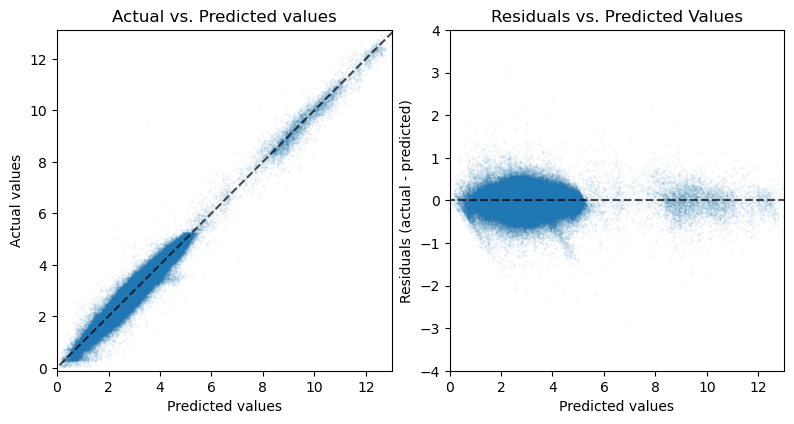

0.9681731253488297


/home/sat/anaconda3/envs/py312scikitlearn/lib/python3.12/site-packages/numpy/lib/function_base.py:522: RuntimeWarning: overflow encountered in cast
  scl = avg_as_array.dtype.type(a.size/avg_as_array.size)


In [23]:
#prediction on trained molecules
fig, axs = plt.subplots(ncols=2, figsize=(8, 4))
plt.tight_layout()
PED.from_predictions(
    y_train,
    y_pred=y_pred_train,
    kind="actual_vs_predicted",
    subsample=None,
    ax=axs[0],
    random_state=0,
    scatter_kwargs={"s":0.4,"alpha":0.05}
)
axs[0].set_title("Actual vs. Predicted values")
axs[0].set_ylim(0,13)
axs[0].set_xlim(0,13)
axs[0].set_xticks(range(0,14,2))
axs[0].set_yticks(range(0,14,2))

PED.from_predictions(
    y_train,
    y_pred=y_pred_train,
    kind="residual_vs_predicted",
    subsample=None,
    ax=axs[1],
    random_state=0,
    scatter_kwargs={"s":0.4,"alpha":0.05}
)
axs[1].set_title("Residuals vs. Predicted Values")
axs[1].set_xlim(0,13)
axs[1].set_ylim(-4,4)
#fig.suptitle("Plotting cross-validated predictions")
#plt.title("pred vs. test")
plt.show()
print(r2_score(y_pred=y_pred_train,y_true=y_train))

In [22]:
y_pred=reg.predict(X_test)

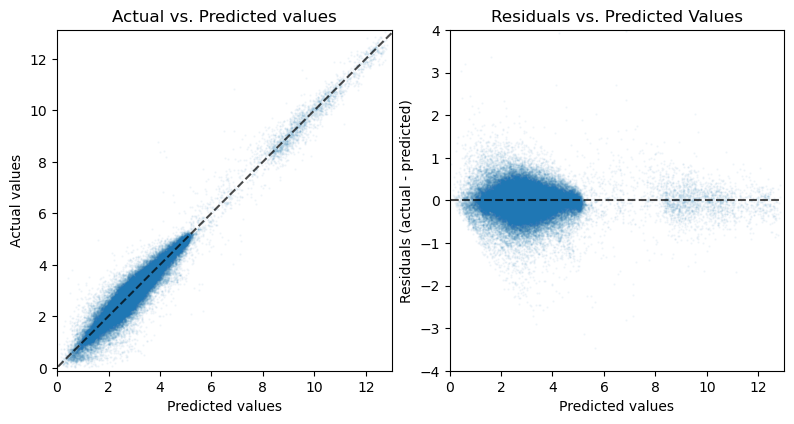

0.946378214751726


/home/sat/anaconda3/envs/py312scikitlearn/lib/python3.12/site-packages/numpy/lib/function_base.py:522: RuntimeWarning: overflow encountered in cast
  scl = avg_as_array.dtype.type(a.size/avg_as_array.size)


In [24]:
#prediction on untrained/test molecules
fig, axs = plt.subplots(ncols=2, figsize=(8, 4))
plt.tight_layout()
PED.from_predictions(
    y_test,
    y_pred=y_pred,
    kind="actual_vs_predicted",
    subsample=None,
    ax=axs[0],
    random_state=0,
    scatter_kwargs={"s":0.4,"alpha":0.05}
)
axs[0].set_title("Actual vs. Predicted values")
axs[0].set_ylim(0,13)
axs[0].set_xlim(0,13)
axs[0].set_xticks(range(0,14,2))
axs[0].set_yticks(range(0,14,2))

PED.from_predictions(
    y_test,
    y_pred=y_pred,
    kind="residual_vs_predicted",
    subsample=None,
    ax=axs[1],
    random_state=0,
    scatter_kwargs={"s":0.40,"alpha":0.05}
)
axs[1].set_title("Residuals vs. Predicted Values")
axs[1].set_xlim(0,13)
axs[1].set_ylim(-4,4)
#fig.suptitle("Plotting cross-validated predictions")
#plt.title("pred vs. test")
plt.show()
print(r2_score(y_pred=y_pred,y_true=y_test))

In [25]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 406203 entries, 0 to 406202
Data columns (total 57 columns):
 #   Column                    Non-Null Count   Dtype  
---  ------                    --------------   -----  
 0   MaxAbsEStateIndex         406203 non-null  float64
 1   MinAbsEStateIndex         406203 non-null  float64
 2   MinEStateIndex            406203 non-null  float64
 3   SPS                       406203 non-null  float64
 4   MolWt                     406203 non-null  float64
 5   NumRadicalElectrons       406203 non-null  int64  
 6   AvgIpc                    406203 non-null  float64
 7   BalabanJ                  406203 non-null  float64
 8   HallKierAlpha             406203 non-null  float64
 9   Ipc                       406203 non-null  float64
 10  PEOE_VSA11                406203 non-null  float64
 11  PEOE_VSA12                406203 non-null  float64
 12  PEOE_VSA13                406203 non-null  float64
 13  PEOE_VSA14                406203 non-null  f

## analyse random search MLPR

In [26]:
#ff=open("/home/sat/ML_GAP/MLPR_descr/log2000_0.log","r")
#ff=open("/home/sat/ML_GAP/MLPR_descr/slurm-512757.out","r")
ff=open("/home/sat/ML_GAP/MLPR_descr/slurm-512759.out","r")

rr=ff.read().splitlines()
rr=[x for x in rr if "CV" in x]
rr=[x.replace("END ","") for x in rr]
rr=[x.replace("CV ","CV=") for x in rr]
rr=[x.replace("[","") for x in rr]
rr=[x.replace("]",",") for x in rr]
rr=[x.replace("/2","") for x in rr]
rr=[x.replace("/3","") for x in rr]
rr=[x.replace("/4","") for x in rr]
rr=[x.replace(";","") for x in rr]
rr=[x.replace(")","),") for x in rr]
rr=[x.replace(",,",",") for x in rr]
#rr=[y.split("=")[1] for y in x for x in rr]
rr=[x.split("=") for x in rr]
rm_list=["CV","alpha","beta_1","hidden_layer_sizes","max_iter","n_iter_no_change","tol","score","test","train","time","total","min",",","\(","\)","s"]
for nrun,run in enumerate(rr):
    for num,item in enumerate(run):
        for rm in rm_list:
            item=re.sub(rm,"",item)
        run[num]=item
    rr[nrun]=list(filter(None,run))

<>:19: SyntaxWarning: invalid escape sequence '\('
<>:19: SyntaxWarning: invalid escape sequence '\)'


In [27]:
pd.set_option("display.precision", 8)
pd.set_option('display.min_rows', 40)
cols= ["CV","alpha","beta_1","hidden_layers","max_iter","n_iter_no_change","tol","score_train","score_test","time"] #["CV","learning_rate","loss","max_depth","n_estimators","subsample","score_train","score_test","train_time"]
dty={"CV":np.int16,
     "alpha":np.float32,
     "beta_1":np.float32,
     "hidden_layers":object,
     "max_iter":np.int16,
     "n_iter_no_change":np.int16,
     "tol":np.float32,
     "score_train":np.float32,
     "score_test":np.float32,
     "time":np.float32
    }
frame=pd.DataFrame(data=rr, columns=cols)#,dtype=dty)
frame=frame.astype(dtype=dty)
frame["hidden_layers"]=[x.split() for x in frame["hidden_layers"]]
frame["hidden_layers"]=[[int(y) for y in x] for x in frame["hidden_layers"]]
frame["hl_sum"]=[sum(x) for x in frame["hidden_layers"]]
frame["hl_len"]=[len(x) for x in frame["hidden_layers"]]
print(len(frame)/4)
frame.sort_values(by='beta_1',ascending=False)

4000.0


,CV,alpha,beta_1,hidden_layers,max_iter,n_iter_no_change,tol,score_train,score_test,time,hl_sum,hl_len
803,1,0.00018194,0.99897206,"[300, 200, 100, 50]",500,5,0.0005,0.95899999,0.93900001,10.19999981,650,4
797,2,0.00018194,0.99897206,"[300, 200, 100, 50]",500,5,0.0005,0.95499998,0.93699998,8.60000038,650,4
799,4,0.00018194,0.99897206,"[300, 200, 100, 50]",500,5,0.0005,0.95099998,0.93500000,8.89999962,650,4
800,3,0.00018194,0.99897206,"[300, 200, 100, 50]",500,5,0.0005,0.95400000,0.93599999,9.39999962,650,4
1527,3,0.00014824,0.99893600,"[300, 150]",500,5,0.0005,0.94700003,0.93300003,6.00000000,450,2
1529,1,0.00014824,0.99893600,"[300, 150]",500,5,0.0005,0.94499999,0.93000001,7.30000019,450,2
1528,2,0.00014824,0.99893600,"[300, 150]",500,5,0.0005,0.94700003,0.93099999,6.69999981,450,2
1530,4,0.00014824,0.99893600,"[300, 150]",500,5,0.0005,0.94599998,0.93199998,5.59999990,450,2
14107,4,0.00020237,0.99886310,"[200, 100]",500,5,0.0005,0.94000000,0.92699999,3.20000005,300,2
14102,1,0.00020237,0.99886310,"[200, 100]",500,5,0.0005,0.94099998,0.92900002,3.00000000,300,2


In [28]:
#df_avg=frame.sort_values(by='beta_1',ascending=False).iloc[0:4,:].mean(numeric_only=True) #cols=["alpha","beta_1","max_iter","n_iter_no_change","tol","score_train","score_test","time"]
#df_avg

In [29]:
df_avg=frame.drop("hidden_layers",axis=1).sort_values(by='beta_1',ascending=False).groupby(np.arange(len(frame.index))//4).mean()
df_avg.sort_values(by=['score_test','score_train'],ascending=[False,False])

,CV,alpha,beta_1,max_iter,n_iter_no_change,tol,score_train,score_test,time,hl_sum,hl_len
2967,2.5,0.00019715,0.92626321,500.0,5.0,0.0005,0.97100002,0.94375002,23.00000000,650.0,4.0
3770,2.5,0.00008878,0.90606046,500.0,5.0,0.0005,0.97150004,0.94350004,21.47499847,650.0,4.0
2276,2.5,0.00010900,0.94328004,500.0,5.0,0.0005,0.97075003,0.94350004,19.60000038,650.0,4.0
1588,2.5,0.00008890,0.96003222,500.0,5.0,0.0005,0.97049999,0.94350004,20.10000038,650.0,4.0
2526,2.5,0.00006785,0.93746918,500.0,5.0,0.0005,0.97049999,0.94350004,22.22500038,650.0,4.0
2764,2.5,0.00010485,0.93134320,500.0,5.0,0.0005,0.97049999,0.94350004,21.20000076,650.0,4.0
1693,2.5,0.00013646,0.95794082,500.0,5.0,0.0005,0.97025001,0.94350004,19.04999924,650.0,4.0
2408,2.5,0.00009408,0.94023424,500.0,5.0,0.0005,0.97025001,0.94350004,22.32500076,650.0,4.0
3976,2.5,0.00017487,0.90053511,500.0,5.0,0.0005,0.97000003,0.94350004,17.39999962,650.0,4.0
2195,2.5,0.00018965,0.94523191,500.0,5.0,0.0005,0.96950001,0.94350004,22.17499924,650.0,4.0


In [30]:
 #datetime.timedelta(minutes=2.9)

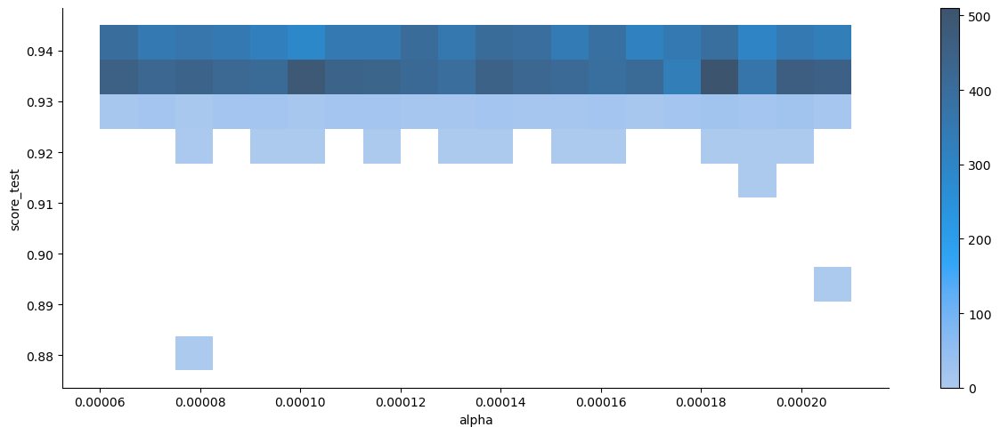

In [31]:
kwargs={"discrete":(False,False), "bins":(20,10),"cbar":True}
plot=sns.displot(frame, x="alpha",y="score_test",height=5, aspect=2.5,legend=True,kind='hist',**kwargs)

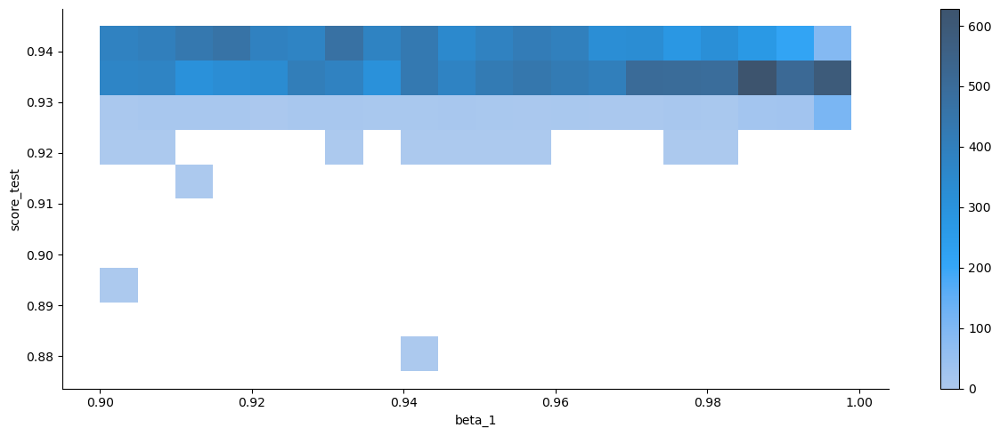

In [32]:
kwargs={"discrete":(False,False), "bins":(20,10),"cbar":True}
plot=sns.displot(frame, x="beta_1",y="score_test",height=5, aspect=2.5,legend=True,kind='hist',**kwargs)

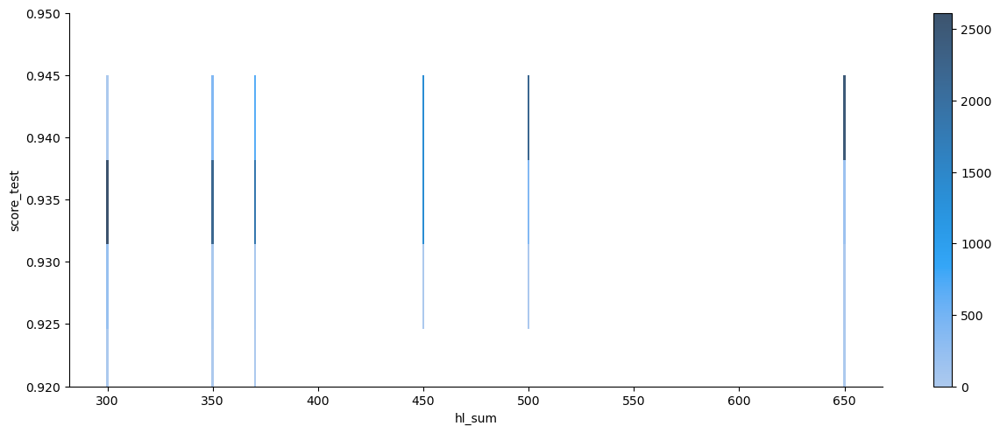

In [33]:
kwargs={"discrete":(True,False), "bins":(10,10),"cbar":True}
plot=sns.displot(frame, x="hl_sum",y="score_test",height=5, aspect=2.5,legend=True,kind='hist',**kwargs)
plot.set(ylim=(0.92,0.95))

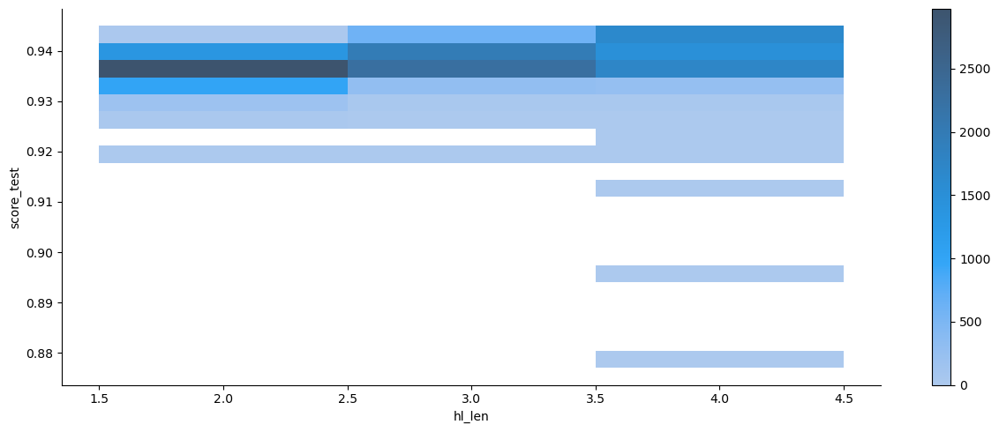

In [34]:
kwargs={"discrete":(True,False), "bins":(3,20),"cbar":True}
plot=sns.displot(frame, x="hl_len",y="score_test",height=5, aspect=2.5,legend=True,kind='hist',**kwargs)
#plot.set(ylim=(0.88,0.94))

In [37]:
fits=16000
ac=15000
elapsed=6*24+21.4 #h
pa=ac/(elapsed)
(fits-ac)/pa

11.026666666666667